# CS-867 Computer Vision Lab 3

In this lab we are going to learn the following:

*   Use a pretrained model
  * Difference between Fine-tuning and linear probing
  * Freeze and unfreeze weights of a model
  * Edit layers in a model
  * Add new layers in a model
* Tensorboard
  * Log data
  * Visualize the model
* Feature/Layer Visualization
* GradCAM (Gradient Activation Mapping)
* Discuss Batch Norm
*   Checkpointing: Saving the optimizer, scheduler and other metrics along with the model for resuming training in the future


# Package installations and imports  

In [ ]:
import torch
import torchvision
import os
from PIL import Image
import matplotlib.pyplot as plt
%matplotlib inline
import torch.nn as nn
import numpy as np
from tqdm import tqdm
from torchsummary import summary

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

In [ ]:
!pip install --upgrade --no-cache-dir gdown

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# Data Preparation

## Vegetable Dataset

For this lab, we will be using only the test set of the Vegetable Dataset as our working dataset consisting of only 3000 Images because today's lab is about using pretrained networks and how can we achieve good performance with them when we have less amounts of data. We will divide this data into train, validation and test sets (with a split of 70%, 15% and 15%, respectively. Another purpose of doing this is to perform quick train, validation and testing experiments with a small dataset. 

Train: 2100

Val: 450

Test: 450

https://www.kaggle.com/datasets/misrakahmed/vegetable-image-dataset

## Download and unzip the dataset

In [ ]:
# download test_set
!gdown https://drive.google.com/uc?id=1TJa3_Exb1mUZzUvrDYsBzL1zzwJYywNP

Downloading...
From: https://drive.google.com/uc?id=1TJa3_Exb1mUZzUvrDYsBzL1zzwJYywNP
To: /content/vegetable_test.zip
100% 80.3M/80.3M [00:00<00:00, 292MB/s]


In [ ]:
%%capture
!unzip /content/vegetable_test.zip;

## Loading the train, val and test sets from their respective folders

### Initializing ImageFolder (dataset) Instances

In [ ]:
image_size = 224
batch_size = 64

In this lab, we will learn about using pre-trained models. 

In order to quickly execute training loops and prove that using pretrained models help us achieve good results with less amounts of data we will use split the test set of the vegetable dataset as the train_set, val_set and test_set.

In [ ]:
transform = torchvision.transforms.Compose([torchvision.transforms.ToTensor(), torchvision.transforms.Resize((image_size,image_size))])

In [ ]:
# path to our datset
data_path = '/content/vegetable_test'

#Initialize the dataset instance from the given datapath
data_set = torchvision.datasets.ImageFolder(root=data_path, transform=transform)

In [ ]:
# Split the dataset into train, validation and test splits
train_set, val_set, test_set = torch.utils.data.random_split(data_set, [2100, 450, 450], generator=torch.Generator().manual_seed(42))

In [ ]:
# Class to number of instances
# caution: takes some time to complete for large datasets
total = 0
class_counts = np.zeros(len(train_set.dataset.classes))
for image, label in train_set:
    class_counts[label] += 1
    total +=1
for i in range(len(class_counts)):
  print("class:%s, instances: %d"%([k for k,v in train_set.dataset.class_to_idx.items() if v == i], class_counts[i]))

class:['Bean'], instances: 145
class:['Bitter_Gourd'], instances: 141
class:['Bottle_Gourd'], instances: 138
class:['Brinjal'], instances: 144
class:['Broccoli'], instances: 126
class:['Cabbage'], instances: 134
class:['Capsicum'], instances: 141
class:['Carrot'], instances: 155
class:['Cauliflower'], instances: 133
class:['Cucumber'], instances: 144
class:['Papaya'], instances: 142
class:['Potato'], instances: 143
class:['Pumpkin'], instances: 128
class:['Radish'], instances: 144
class:['Tomato'], instances: 142


In [ ]:
# Print the classes in the dataset
classes = None
if hasattr(train_set, 'classes'):
      classes = train_set.classes
elif hasattr(train_set, 'dataset') and hasattr(train_set.dataset, 'classes'):
      classes = train_set.dataset.classes

classes

['Bean',
 'Bitter_Gourd',
 'Bottle_Gourd',
 'Brinjal',
 'Broccoli',
 'Cabbage',
 'Capsicum',
 'Carrot',
 'Cauliflower',
 'Cucumber',
 'Papaya',
 'Potato',
 'Pumpkin',
 'Radish',
 'Tomato']

## Function for visualizing images of dataset object 

In [ ]:
def show_dataset_samples(data_set):
    loader = torch.utils.data.DataLoader(
    data_set,
    batch_size=32,
    shuffle=True)

  # Get a batch of images from the train_loader
    images, labels = next(iter(loader))

    rows = col = 3
    #fig, axes = plt.subplots(nrows=5, ncols=5)                          )
    plt.figure(figsize = (10,10))

    for i in range(rows*col):
      # Plot a random image from the batch
      random_index = np.random.randint(0, images.shape[0])
      image = images[random_index]
      label = labels[random_index]
      plt.subplot(rows, col, i+1)
      plt.axis('off')
      plt.imshow(image.permute(1,2,0))
      
      if hasattr(train_set, 'classes'):
        classes = train_set.classes
      elif hasattr(train_set, 'dataset') and hasattr(train_set.dataset, 'classes'):
        classes = train_set.dataset.classes

      plt.title(f'Label: {classes[label]}')

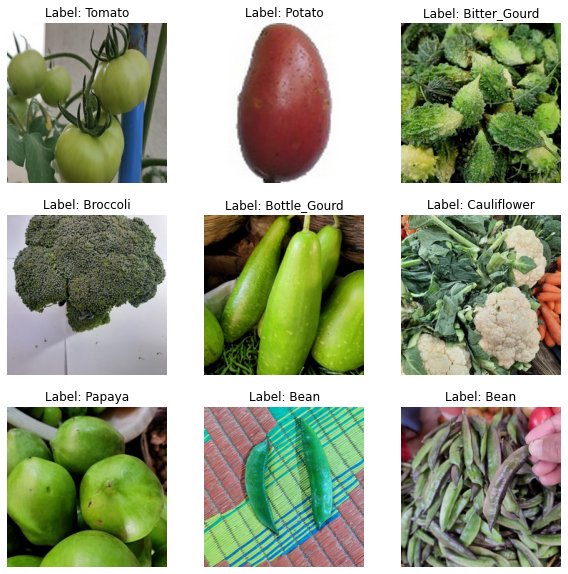

In [ ]:
show_dataset_samples(train_set)

## Compute standardization parameters and apply

In [ ]:
def get_mean_and_std(dataloader):
    channels_sum, channels_squared_sum, num_batches = 0, 0, 0
    for data, _ in dataloader:
        # Mean over batch, height and width, but not over the channels
        channels_sum += torch.mean(data, dim=[0,2,3])
        channels_squared_sum += torch.mean(data**2, dim=[0,2,3])
        num_batches += 1
    
    mean = channels_sum / num_batches

    # std = sqrt(E[X^2] - (E[X])^2)
    std = (channels_squared_sum / num_batches - mean ** 2) ** 0.5

    return mean, std

# https://towardsdatascience.com/how-to-calculate-the-mean-and-standard-deviation-normalizing-datasets-in-pytorch-704bd7d05f4c

In [ ]:
# Create a dummy dataloader for our train_set
dataloader = torch.utils.data.DataLoader(dataset=train_set, batch_size=32)
# Call the function and compute mean and std
mean, std = get_mean_and_std(dataloader)
print(mean, std)

tensor([0.4681, 0.4648, 0.3448]) tensor([0.2339, 0.2294, 0.2437])


In [ ]:
# Add the new normalization to the existing transforms
normalize = torchvision.transforms.Normalize(mean=mean, std=std)
transform = torchvision.transforms.Compose([transform, normalize])

In [ ]:
# A function for updating the transforms of our dataset objects
def update_transform(dataset, transform):
    if hasattr(dataset, 'transform'):
      dataset.transform = transform
      dataset.transform
    elif hasattr(dataset, 'dataset') and hasattr(dataset.dataset, 'transform'):
      dataset.dataset.transform = transform
      dataset.dataset.transform
    else:
      print("No transform attribute found.")

In [ ]:
# Add the normalization transform to the datasets
# using the "update_transform" function
update_transform(train_set, transform)
update_transform(val_set, transform)
update_transform(test_set, transform)

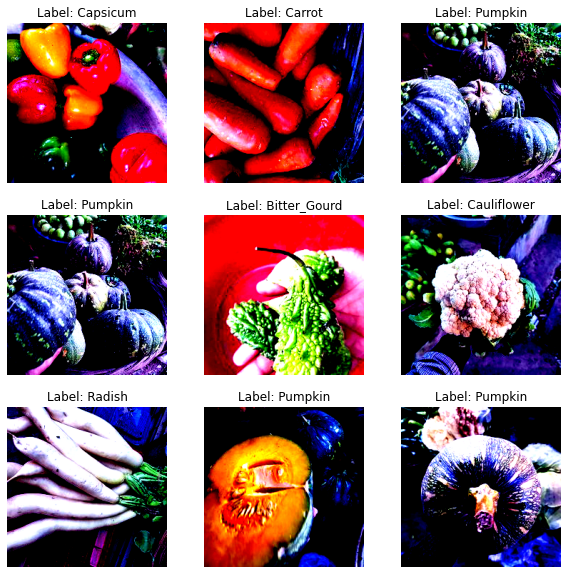

In [ ]:
### Visualize the images with the new normalization transform
show_dataset_samples(train_set)

## Data Augmentation

In [ ]:
# composing transforms instance for data augmentation
augmentation_transforms = torchvision.transforms.Compose([transform,
    torchvision.transforms.RandomHorizontalFlip(),
    torchvision.transforms.RandomVerticalFlip(),
    torchvision.transforms.RandomRotation(degrees=45),
    torchvision.transforms.GaussianBlur(5)
    ])

# Add the augmentation_transfomers to the train_set
update_transform(train_set, transform)

## Initializing the pytorch dataloaders and visualize train examples

In [ ]:
train_loader = torch.utils.data.DataLoader(
    train_set,
    batch_size=batch_size,
    shuffle=True
)

val_loader = torch.utils.data.DataLoader(
    val_set,
    batch_size=batch_size,
    shuffle=False
)

test_loader = torch.utils.data.DataLoader(
    test_set,
    batch_size=batch_size,
    shuffle=False
)


# Convolutional Neural Networks

# Torchvision pretrained VGG19 Model

In [ ]:
# https://pytorch.org/vision/stable/models.html
model = torchvision.models.vgg19(pretrained= True)

# Alternate method of initialization:
# modelVGG = torchvision.models.vgg19(weights=torchvision.models.VGG19_Weights)

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


The "parameters()" attribute of a model returns us a generator that iteratively provides us the parameters of each layer of the model.

In the code below, we use a for loop to iterate over the parameters of each layer in the model.

The requires_grad flag for parameters of a layer signifies whether to calculate the gradients for those parameters when doing a backward pass. So initially we set requires_grad to false for parameters of all the layers

In [ ]:
for param in model.parameters():
    param.requires_grad = False

In [ ]:
model

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

### Replace an exisiting layer in model (VGG19)

The VGG19 model is divided into two sequential parts: First one is the "features" module and the second one is the classifer module. The "features" module consists of all the 2D opertation layers and the "classifier" module consists of all the fully connected layers.

In our case, the vegetable dataset has 15 classes, so we initialize a new layer and replace the last linear layer of the classifier that has 1000 outputs for 1000 classes of imagenet with the new layer with 15 outputs.


In [ ]:
model.classifier[-1] = nn.Linear(in_features=4096, out_features= 15)

### named_parameters() and children() attributes

In [ ]:
model.named_parameters()

<generator object Module.named_parameters at 0x7fe1ab9135f0>

In [ ]:
for name, parameter in model.named_parameters():
  print('Name: %s,\tShape: %s'%(name, parameter.size()))

In [ ]:
for name, parameter in model.named_parameters():
  if name.startswith('classifier.'):
    print('Name: %s,\tShape: %s'%(name, parameter.size()))

Name: classifier.0.weight,	Shape: torch.Size([4096, 25088])
Name: classifier.0.bias,	Shape: torch.Size([4096])
Name: classifier.3.weight,	Shape: torch.Size([4096, 4096])
Name: classifier.3.bias,	Shape: torch.Size([4096])
Name: classifier.6.weight,	Shape: torch.Size([15, 4096])
Name: classifier.6.bias,	Shape: torch.Size([15])


In [ ]:
model.features.children()

<generator object Module.children at 0x7fd2ac5faa50>

### Adding new layers in pretrianed model (VGG16):

(Do not run this code, if inferencing or evaluating through the downloaded VGG model for the vegetable dataset with 15 classes.

In [ ]:
model

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

In [ ]:
new_conv2d = nn.Conv2d(256, 256,3,1,1)

In [ ]:
model.features.insert(17, new_conv2d)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): Conv2d(256, 256, kernel_size=(3, 

Adding a layer at the start or at the end (Alternate Method)

In [ ]:
new_conv2d = nn.Conv2d(3,3,3,1,1)

In [ ]:
model.features.children()

<generator object Module.children at 0x7fe1ab913d60>

In [ ]:
features_block = list(model.features.children())
features_block

[Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 ReLU(inplace=True),
 Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 ReLU(inplace=True),
 MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False),
 Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 ReLU(inplace=True),
 Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 ReLU(inplace=True),
 MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False),
 Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 ReLU(inplace=True),
 Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 ReLU(inplace=True),
 Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 ReLU(inplace=True),
 Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 ReLU(inplace=True),
 MaxPool2d(kernel_size=2, stride=2, padding=0, dilatio

In [ ]:
new_features_block = nn.Sequential(new_conv2d, *features_block)

In [ ]:
model.features = new_features_block
model

VGG(
  (features): Sequential(
    (0): Conv2d(3, 3, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (2): ReLU(inplace=True)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (11): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (12): ReLU(inplace=True)
    (13): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (14): ReLU(inplace=True)
    (15): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (16): ReLU(inplac

# Model Configuration

## Loss Function and Optimizer Selection

In [ ]:
# Select a loss function
loss_function = torch.nn.CrossEntropyLoss()

# Select an optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

# Define the learning rate scheduler
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=40, gamma=0.1)
# For more on schedulers please visit:
# https://towardsdatascience.com/a-visual-guide-to-learning-rate-schedulers-in-pytorch-24bbb262c863

# Set the number of epochs
# This variable is used in the main training loop
epochs = 10

model.to(device);


In [ ]:
epochs = 20

# Training

## Function for running the model over all the samples of a given dataloader object

In [ ]:
def run_1_epoch(model, loss_fn, loader, optimizer = None, train = False):
  
  if train:
    model.train()
  else:
    model.eval()


  total_correct_preds = 0
  
  total_loss = 0

  # Number of images we can get by the loader
  total_samples_in_loader = len(loader.dataset)
  
  # number of batches we can get by the loader 
  total_batches_in_loader = len(loader)

  for image_batch, labels in tqdm(loader):
    
    # Transfer image_batch to GPU if available
    image_batch = image_batch.to(device)
    labels = labels.to(device)
    
    # Zeroing out the gradients for parameters
    if train:
      assert optimizer is not None, "Optimizer must be provided if train=True"
      optimizer.zero_grad()
    
    # Forward pass on the input batch
    output = model(image_batch)

    # Acquire predicted class indices
    _, predicted = torch.max(output.data, 1) # the dimension 1 corresponds to max along the rows 
    
    # Removing extra last dimension from output tensor
    output.squeeze_(-1)

    # Compute the loss for the minibatch
    loss = loss_function(output, labels)
    
    # Backpropagation
    if train:
      loss.backward()
    
    # Update the parameters using the gradients
    if train:
      optimizer.step()
    
    # Extra variables for calculating loss and accuracy
    # count total predictions for accuracy calcutuon for this epoch
    total_correct_preds += (predicted == labels).sum().item()

    total_loss += loss.item()

  loss = total_loss / total_batches_in_loader
  accuracy = 100 * total_correct_preds / total_samples_in_loader

  return loss, accuracy 

## Run this for training from scratch

In [ ]:
# Initializing variables for starting a new training
# Some helper variables

train_accuracy_list = []
val_accuracy_list = []

train_loss_list = []
val_loss_list = []


val_accuracy_max = -1

checkpoint_path = '/content/checkpoint_norm_aug_tensorboard.pth'
best_val_checkpoint_path = '/content/best_val_checkpoint_norm_aug_tensorboard.pth'

# Start epoch is zero for new training
start_epoch = 0

## Run this to continue training froma saved checkpoint

In [ ]:
# Loading all variables from a checkpoint to continue a training

# Path to checkpoint
saved_checkpoint_path = '/content/checkpoint_norm_aug_tensorboard.pth'

# Load the checkpoint
checkpoint = torch.load(saved_checkpoint_path)

# Load all the state_dictionaries of the model, optimizer and schedular
model.load_state_dict(checkpoint['model'])

optimizer.load_state_dict(checkpoint['optimizer'])

scheduler.load_state_dict(checkpoint['scheduler'])

# Epoch to continue from the last training
start_epoch = checkpoint['trianed_epochs'] + 1

# Load the accuracy and loss lists for record keeping
train_accuracy_list = checkpoint['train_accuracies']
val_accuracy_list = checkpoint['val_accuracies']

train_loss_list = checkpoint['train_losses']
val_loss_list = checkpoint['val_losses']

# Load the value of the max val accuracy obtained in the previous training
# This will help us to avoid saving a new model with lower val accuracy 
# over the previously saved model with better val accuracy
val_accuracy_max = checkpoint['val_accuracy_max']

# paths to checkpoint and best val acc model
checkpoint_path = 'checkpoint.pth'
best_val_checkpoint_path = 'best_val_checkpoint.pth'

## Setting up Tensorboard 

In [ ]:
import tensorboard
from torch.utils.tensorboard import SummaryWriter

In [ ]:
# A command starting with % is called a magic command
# This command is used for loading the tensorboard extension for
# enabling it to be able to run in this colab notebook 
%load_ext tensorboard

# Otherwise when it is installed in your PC the tensorboard is run through the
# browser. Once it is run, you use the provided address to access it through
# a browser on your PC.

In [ ]:
# Initialize the SummaryWriter instance. The default log_dir is set to runs/
# Here we have speified our own log directory
writer = SummaryWriter(log_dir="/content/runs/")

In [ ]:
sample_images, labels = next(iter(train_loader))

# The add_graph method is used to visualize the model
# We provide the model and sample image
writer.add_graph(model, sample_images.to(device))

In [ ]:
# The % sign is the magic command for the tensorboard to run in colab
#
%tensorboard --logdir /content/runs/ 

# For more details:
# https://pytorch.org/tutorials/intermediate/tensorboard_tutorial.html

## Main training loop

In [ ]:
# Main training and validation loop for n number of epochs
for epoch in range(start_epoch, epochs):

  # Train model for one epoch

  # Get the current learning rate from the optimizer
  current_lr = optimizer.param_groups[0]['lr']

  print("Epoch %d: Train \nLearning Rate: %.6f"%(epoch, current_lr))
  train_loss, train_accuracy  = run_1_epoch(model, loss_function, train_loader, optimizer, train= True)

  # Update the learning rate scheduler
  scheduler.step()

  # Lists for train loss and accuracy for plotting
  train_loss_list.append(train_loss)
  train_accuracy_list.append(train_accuracy)

  # Validate the model on validation set
  print("Epoch %d: Validation"%(epoch))
  with torch.no_grad():
    val_loss, val_accuracy  = run_1_epoch(model, loss_function, val_loader, optimizer, train= False)
  
  # Lists for val loss and accuracy for plotting
  val_loss_list.append(val_loss)
  val_accuracy_list.append(val_accuracy)

  # The "add_scalar" function adds a new metric to the tensorboard log
  # It is gnerally given 3 arguments:
  # tag: Name of the metric
  # scalar_value = the value of the metric to record
  # global_step = on which milestone to record the scalar value which in our
  # case is the epoch
  writer.add_scalar(tag = "Loss/train", scalar_value = train_loss, global_step = epoch)
  writer.add_scalar(tag = "accuracy/train", scalar_value = train_accuracy, global_step = epoch)

  writer.add_scalar(tag = "Loss/val", scalar_value = val_loss, global_step = epoch)
  writer.add_scalar(tag = "accuracy/val", scalar_value = val_accuracy, global_step = epoch)

  print('train loss: %.4f'%(train_loss))
  print('val loss: %.4f'%(val_loss))
  print('train_accuracy %.2f' % (train_accuracy))
  print('val_accuracy %.2f' % (val_accuracy))
  
  # Save model if validation accuracy for current epoch is greater than 
  # all the previous epochs 
  if val_accuracy > val_accuracy_max:
    val_accuracy_max = val_accuracy
    print("New max val Accuracy Acheived %.2f. Saving model.\n\n"%(val_accuracy_max))

    checkpoint = {
    'model': model.state_dict(),
    'optimizer': optimizer.state_dict(),
    'scheduler': scheduler.state_dict(),
    'trianed_epochs': epoch,
    'train_losses': train_loss_list,
    'train_accuracies': train_accuracy_list,
    'val_losses': val_loss_list,
    'val_accuracies': val_accuracy_list,
    'val_accuracy_max': val_accuracy_max,
    'lr': optimizer.param_groups[0]['lr']
    }
    torch.save(checkpoint, best_val_checkpoint_path)

  else:
    print("val accuracy did not increase from %.2f\n\n"%(val_accuracy_max))

# Save checkpoint for the last epoch
  checkpoint = {
    'model': model.state_dict(),
    'optimizer': optimizer.state_dict(),
    'scheduler': scheduler.state_dict(),
    'trianed_epochs': epoch,
    'train_losses': train_loss_list,
    'train_accuracies': train_accuracy_list,
    'val_losses': val_loss_list,
    'val_accuracies': val_accuracy_list,
    'val_accuracy_max': val_accuracy_max,
    'lr': optimizer.param_groups[0]['lr']
    }

  torch.save(checkpoint, checkpoint_path)
  writer.flush()


Epoch 10: Train 
Learning Rate: 0.001000


100%|██████████| 33/33 [00:17<00:00,  1.87it/s]


Epoch 10: Validation


100%|██████████| 8/8 [00:04<00:00,  1.77it/s]


train loss: 0.0228
val loss: 0.0287
train_accuracy 99.71
val_accuracy 99.33
val accuracy did not increase from 99.56


Epoch 11: Train 
Learning Rate: 0.001000


100%|██████████| 33/33 [00:18<00:00,  1.79it/s]


Epoch 11: Validation


100%|██████████| 8/8 [00:03<00:00,  2.02it/s]


train loss: 0.0193
val loss: 0.0269
train_accuracy 99.67
val_accuracy 99.78
New max val Accuracy Acheived 99.78. Saving model.


Epoch 12: Train 
Learning Rate: 0.001000


100%|██████████| 33/33 [00:17<00:00,  1.88it/s]


Epoch 12: Validation


100%|██████████| 8/8 [00:04<00:00,  1.99it/s]


train loss: 0.0188
val loss: 0.0265
train_accuracy 99.71
val_accuracy 99.78
val accuracy did not increase from 99.78


Epoch 13: Train 
Learning Rate: 0.001000


100%|██████████| 33/33 [00:18<00:00,  1.75it/s]


Epoch 13: Validation


100%|██████████| 8/8 [00:04<00:00,  1.77it/s]


train loss: 0.0183
val loss: 0.0306
train_accuracy 99.62
val_accuracy 98.89
val accuracy did not increase from 99.78


Epoch 14: Train 
Learning Rate: 0.001000


100%|██████████| 33/33 [00:19<00:00,  1.72it/s]


Epoch 14: Validation


100%|██████████| 8/8 [00:04<00:00,  1.97it/s]


train loss: 0.0214
val loss: 0.0263
train_accuracy 99.48
val_accuracy 99.56
val accuracy did not increase from 99.78


Epoch 15: Train 
Learning Rate: 0.001000


 12%|█▏        | 4/33 [00:02<00:19,  1.49it/s]


KeyboardInterrupt: ignored

In [ ]:
# Copy best model to drive
# You may also directly save the best model to drive during training

!cp /content/best_val_checkpoint.pth /content/drive/MyDrive/Machvis/Labs/trained_models

**Accuracy and Loss Result Graphs:**

Text(0.5, 1.0, 'Training and val Loss')

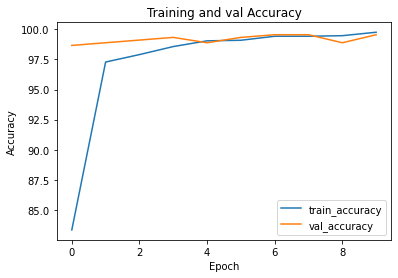

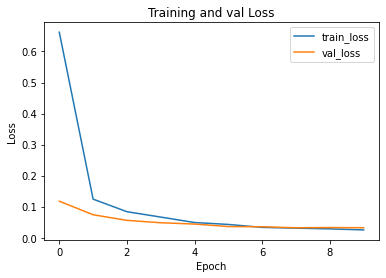

In [ ]:
plt.figure()
plt.plot(train_accuracy_list, label="train_accuracy")
plt.plot(val_accuracy_list, label="val_accuracy")
plt.legend()

plt.xlabel('Epoch')
plt.ylabel('Accuracy')

plt.title('Training and val Accuracy')

plt.figure()
plt.plot(train_loss_list, label="train_loss")
plt.plot(val_loss_list, label="val_loss")

plt.legend()
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and val Loss')

# Evaluating the Model

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


**Loading the best saved model:**

In [ ]:
!gdown https://drive.google.com/file/d/1-BxJbuqNewwB5iw5JkQueBFh_iI_c_9s/view?usp=share_link --fuzzy

Downloading...
From: https://drive.google.com/uc?id=1-BxJbuqNewwB5iw5JkQueBFh_iI_c_9s
To: /content/best_val_checkpoint.pth
100% 559M/559M [00:14<00:00, 37.7MB/s]


In [ ]:
best_val_model_path = '/content/best_val_checkpoint.pth'
best_val_checkpoint = torch.load(best_val_model_path, map_location=torch.device(device))

In [ ]:
# Before loading the state_dict of the model, make sure the "model" instance is 
# initiated by its corresponding class e.g. VGG16
model.load_state_dict(best_val_checkpoint['model'])

<All keys matched successfully>

In [ ]:
with torch.no_grad():
    test_loss, test_accuracy  = run_1_epoch(model, loss_function, test_loader, train= False)

print('test loss: %.4f'%(test_loss))
print('test_accuracy %.2f' % (test_accuracy))


100%|██████████| 8/8 [00:04<00:00,  1.81it/s]

test loss: 0.0424
test_accuracy 98.89


In [ ]:
# Get a batch of images from the train_loader
images, labels = next(iter(test_loader))

with torch.no_grad():
  predicted_labels = model(images.to(device))
  predicted_labels = torch.argmax(predicted_labels, 1)
rows = col = 3
#fig, axes = plt.subplots(nrows=5, ncols=5))
plt.figure(figsize = (10,10))

for i in range(rows*col):
  # Plot a random image from the batch
  random_index = np.random.randint(0, images.shape[0])
  image = images[random_index]
  label = labels[random_index]
  pred_label = predicted_labels[random_index]
  plt.subplot(rows, col, i+1)
  plt.axis('off')
  plt.imshow(image.permute(1,2,0))
  plt.title(f'Label: {classes[label]}, Pred: {classes[pred_label]}')

# Feature/Layer Visualization and GradCAM

In [ ]:
# Run in case the dataset is not downloaded
!gdown https://drive.google.com/uc?id=1TJa3_Exb1mUZzUvrDYsBzL1zzwJYywNP

In [ ]:
import cv2 as cv

# Meand and std for standardization of the loaded image
# mean = [0.4681, 0.4648, 0.3448] 
# std = [0.2339, 0.2294, 0.2437]

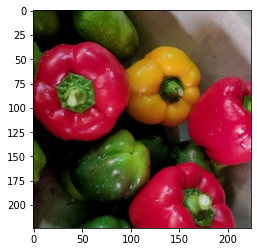

torch.Size([1, 3, 224, 224])


In [ ]:
img=cv.imread("/content/vegetable_test/Capsicum/1001.jpg")
img=cv.cvtColor(img,cv.COLOR_BGR2RGB)
plt.imshow(img)
plt.show()
 
 
transform = torchvision.transforms.Compose([
    torchvision.transforms.ToPILImage(),
    torchvision.transforms.RandomResizedCrop(224),
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Normalize([0.4681, 0.4648, 0.3448], [0.2339, 0.2294, 0.2437])
])
img=np.array(img)
img=transform(img)
img=img.unsqueeze(0)
print(img.size())

## Initialize the pretrained model and load saved weights for our dataset

In [ ]:
# https://pytorch.org/vision/stable/models.html
model = torchvision.models.vgg19(pretrained= True)

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:
model.classifier[-1] = nn.Linear(in_features=4096, out_features= 15)

In [ ]:
!gdown https://drive.google.com/file/d/1-BxJbuqNewwB5iw5JkQueBFh_iI_c_9s/view?usp=share_link --fuzzy

Downloading...
From: https://drive.google.com/uc?id=1-BxJbuqNewwB5iw5JkQueBFh_iI_c_9s
To: /content/best_val_checkpoint.pth
100% 559M/559M [00:03<00:00, 174MB/s]


In [ ]:
best_val_model_path = '/content/best_val_checkpoint_norm_aug_tensorboard.pth'
best_val_checkpoint = torch.load(best_val_model_path, map_location=torch.device(device))

In [ ]:
# Before loading the state_dict of the model, make sure the "model" instance is 
# initiated by its corresponding class e.g. VGG16
model.load_state_dict(best_val_checkpoint['model'])

<All keys matched successfully>

## Visualize Convolution Layers of the model

Credits: https://androidkt.com/how-to-visualize-feature-maps-in-convolutional-neural-networks-using-pytorch/

In [ ]:
model

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

In [ ]:
no_of_layers=0
conv_layers=[]
 
model_children=list(model.children())
 
for child in model_children:
  if type(child)==nn.Conv2d:
    no_of_layers+=1
    conv_layers.append(child)
  elif type(child)==nn.Sequential:
    for layer in child.children():
      if type(layer)==nn.Conv2d:
        no_of_layers+=1
        conv_layers.append(layer)
print(no_of_layers)

16


In [ ]:
results = [conv_layers[0](img)]
names = [str(conv_layers[0])]
for i in range(1, len(conv_layers)):
    results.append(conv_layers[i](results[-1]))
    names.append(str(conv_layers[i]))
outputs = results

In [ ]:
names

['Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))',
 'Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))',
 'Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))',
 'Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))',
 'Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))',
 'Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))',
 'Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))',
 'Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))',
 'Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))',
 'Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))',
 'Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))',
 'Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))',
 'Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))',
 'Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1

In [ ]:
for feature_map in outputs:
    print(feature_map.shape)

torch.Size([1, 64, 224, 224])
torch.Size([1, 64, 224, 224])
torch.Size([1, 128, 224, 224])
torch.Size([1, 128, 224, 224])
torch.Size([1, 256, 224, 224])
torch.Size([1, 256, 224, 224])
torch.Size([1, 256, 224, 224])
torch.Size([1, 256, 224, 224])
torch.Size([1, 512, 224, 224])
torch.Size([1, 512, 224, 224])
torch.Size([1, 512, 224, 224])
torch.Size([1, 512, 224, 224])
torch.Size([1, 512, 224, 224])
torch.Size([1, 512, 224, 224])
torch.Size([1, 512, 224, 224])
torch.Size([1, 512, 224, 224])


Layer  1


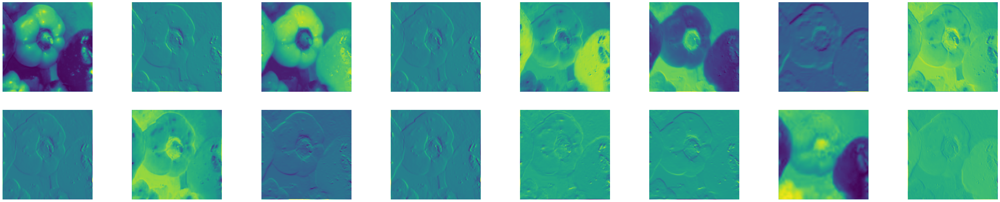

Layer  2


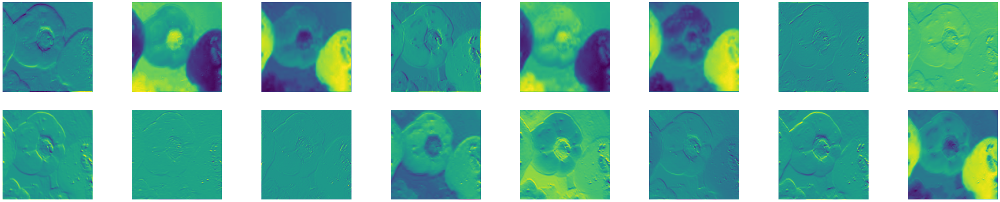

Layer  3


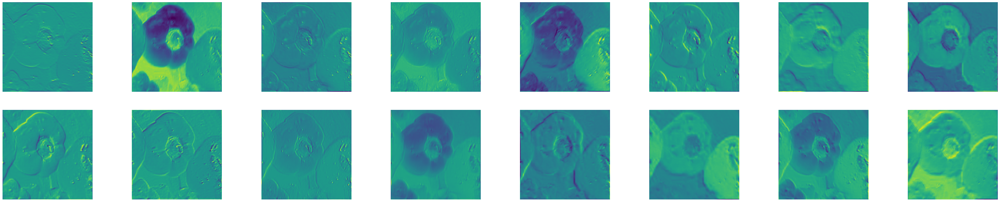

Layer  4


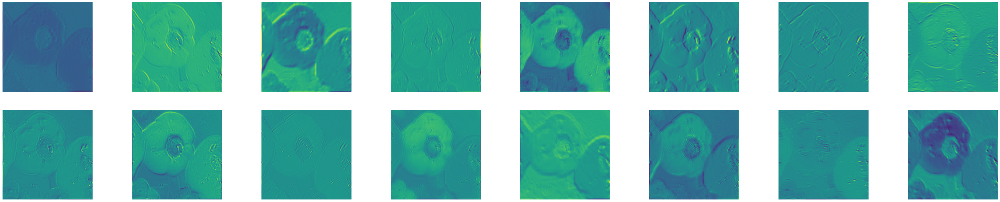

Layer  5


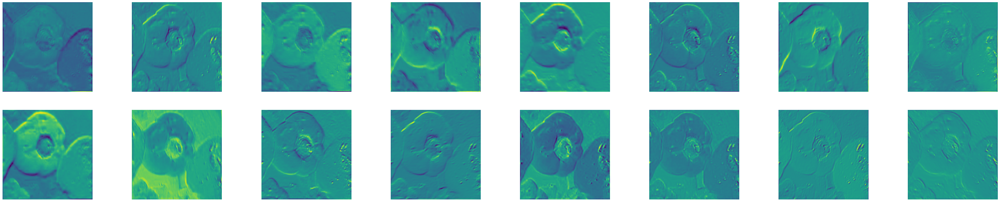

Layer  6


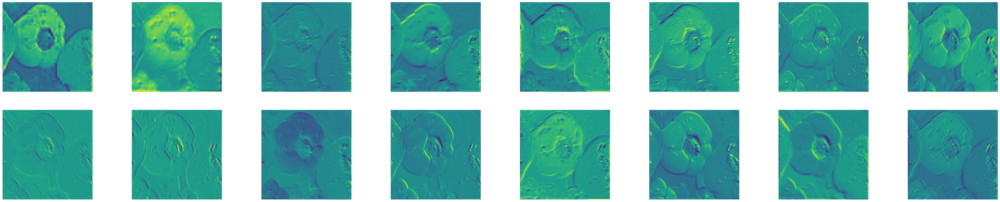

Layer  7


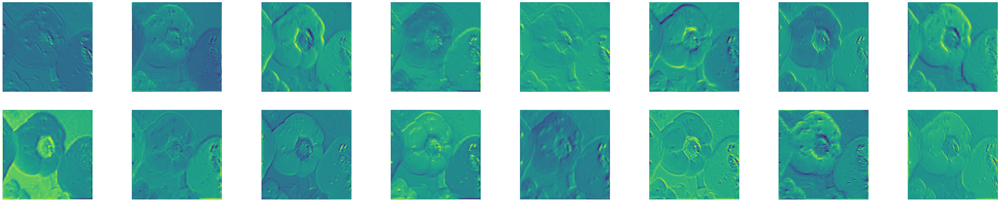

Layer  8


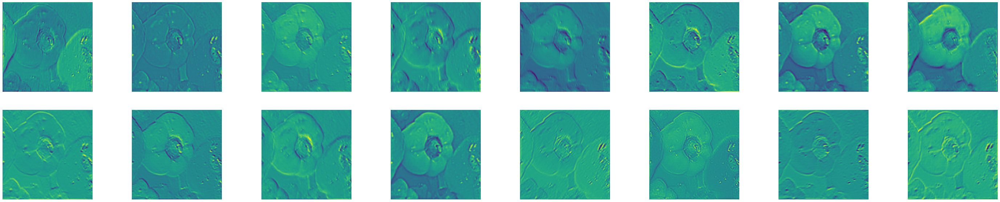

Layer  9


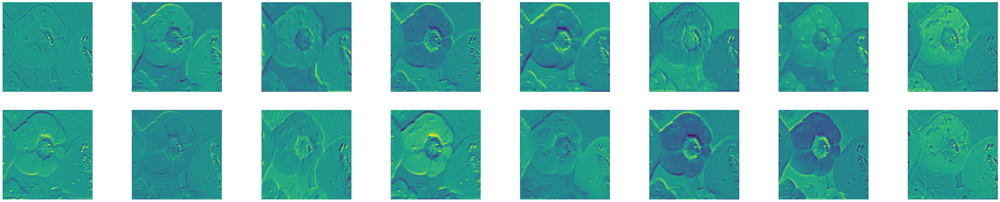

Layer  10


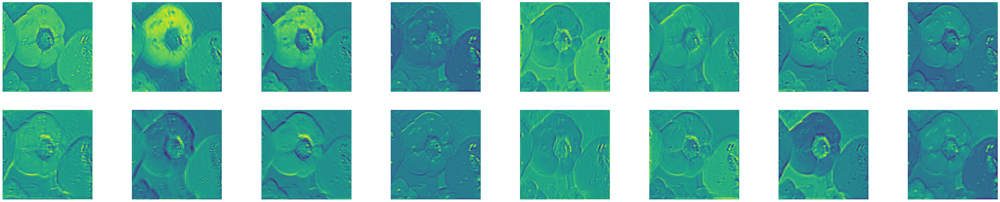

Layer  11


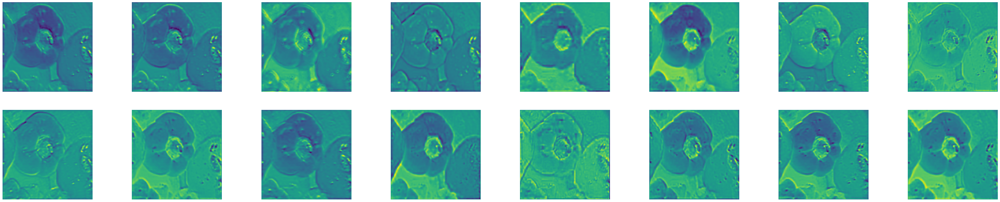

Layer  12


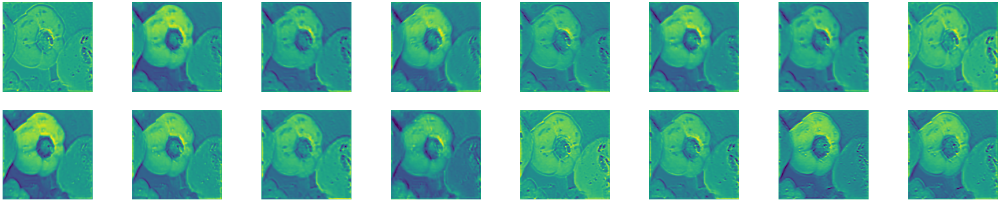

Layer  13


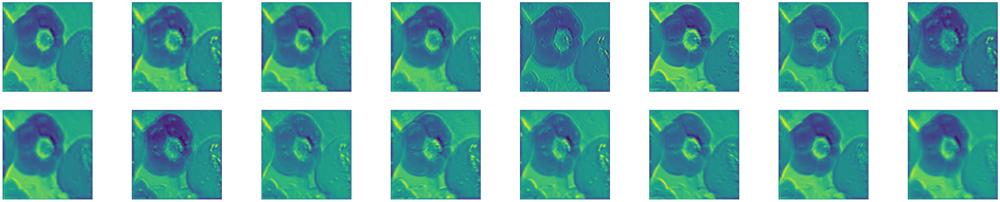

Layer  14


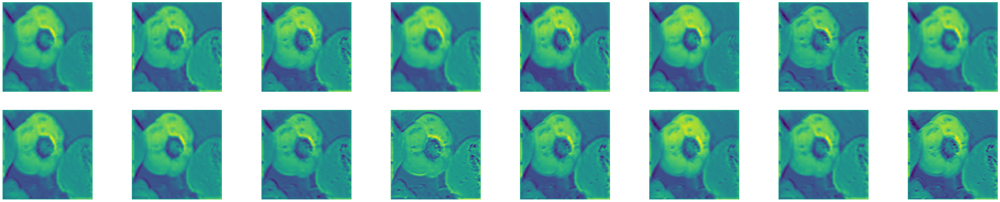

Layer  15


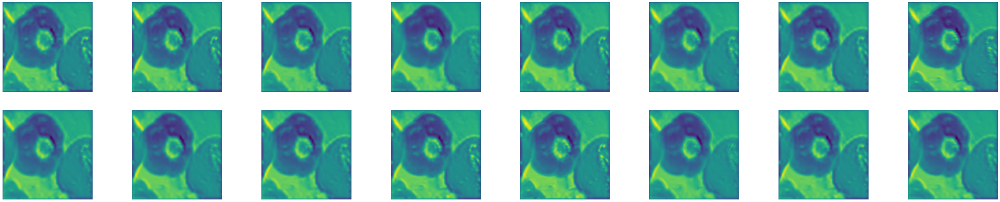

Layer  16


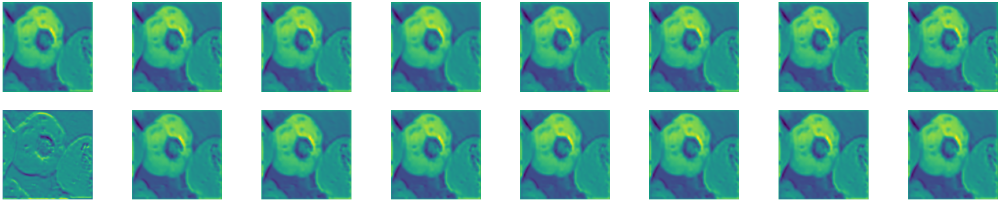

In [ ]:
for num_layer in range(len(outputs)):
    plt.figure(figsize=(50, 10))
    layer_viz = outputs[num_layer][0, :, :, :]
    layer_viz = layer_viz.detach()
    print("Layer ",num_layer+1)
    for i, filter in enumerate(layer_viz):
        if i == 16: 
            break
        plt.subplot(2, 8, i + 1)
        plt.imshow(filter)
        plt.axis("off")
    plt.show()
    plt.close()

# GradCAM (Gradient Class Activation Mapping)

Credits: https://medium.com/@stepanulyanin/implementing-grad-cam-in-pytorch-ea0937c31e82

In [ ]:
model

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

In [ ]:
class VGG_Grad_CAM(nn.Module):
    def __init__(self, model):
        super(VGG_Grad_CAM, self).__init__()
        
        # get the pretrained VGG19 network
        #self.vgg = vgg19(pretrained=True)
        self.model= model
        # disect the network to access its last convolutional layer
        self.features_conv = self.model.features[:36]
        
        # get the max pool of the features stem
        self.max_pool = nn.MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
        
        # get the classifier of the vgg19
        self.classifier = self.model.classifier
        
        # placeholder for the gradients
        self.gradients = None
    
    # hook for the gradients of the activations
    def activations_hook(self, grad):
        self.gradients = grad
        
    def forward(self, x):
        x = self.features_conv(x)
        
        # register the hook
        h = x.register_hook(self.activations_hook)
        
        # apply the remaining pooling
        x = self.max_pool(x)
        x = x.view((1, -1))
        x = self.classifier(x)
        return x
    
    # method for the gradient extraction
    def get_activations_gradient(self):
        return self.gradients
    
    # method for the activation exctraction
    def get_activations(self, x):
        return self.features_conv(x)

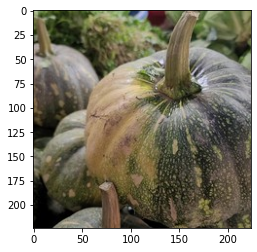

torch.Size([1, 3, 224, 224])


In [ ]:
import cv2 as cv

# Meand and std for standardization of the loaded image
# mean = [0.4681, 0.4648, 0.3448] 
# std = [0.2339, 0.2294, 0.2437]

img_path = '/content/vegetable_test/Pumpkin/1024.jpg'

img=cv.imread(img_path)
img=cv.cvtColor(img,cv.COLOR_BGR2RGB)
plt.imshow(img)
plt.show()
 
 
transform = torchvision.transforms.Compose([
    torchvision.transforms.ToPILImage(),
    torchvision.transforms.Resize(224),
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Normalize([0.4681, 0.4648, 0.3448], [0.2339, 0.2294, 0.2437])
])
img=np.array(img)
img=transform(img)
img=img.unsqueeze(0)
print(img.size())

In [ ]:
# initialize the VGG model
vgg_grad_cam = VGG_Grad_CAM(model)

# set the evaluation mode
vgg_grad_cam.eval()

# get the image from the dataloader
# img, _ = next(iter(test_loader))

# get the most likely prediction of the model
pred = vgg_grad_cam(img)
pred_class = pred.detach().argmax(dim=1)
classes[pred_class]

'Pumpkin'

In [ ]:
# get the gradient of the output with respect to the parameters of the model
pred[:,pred_class].backward()

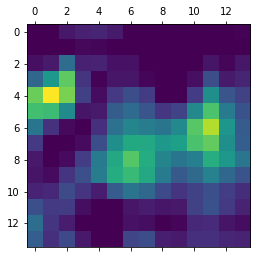

In [ ]:

# pull the gradients out of the model
gradients = vgg_grad_cam.get_activations_gradient()

# pool the gradients across the channels
pooled_gradients = torch.mean(gradients, dim=[0, 2, 3])

# get the activations of the last convolutional layer
activations = vgg_grad_cam.get_activations(img).detach()

# weight the channels by corresponding gradients
for i in range(512):
    activations[:, i, :, :] *= pooled_gradients[i]
    
# average the channels of the activations
heatmap = torch.mean(activations, dim=1).squeeze()

# relu on top of the heatmap
# expression (2) in https://arxiv.org/pdf/1610.02391.pdf
heatmap = np.maximum(heatmap, 0)

# normalize the heatmap
heatmap /= torch.max(heatmap)

# draw the heatmap
plt.matshow(heatmap.squeeze())

In [ ]:
heatmap =heatmap.numpy()

In [ ]:
img=cv.imread(img_path)

In [ ]:
# import cv2
# img = cv2.imread('./data/Elephant/data/05fig34.jpg')
heatmap = cv.resize(heatmap, (img.shape[1], img.shape[0]))
heatmap = np.uint8(255 * heatmap)
heatmap = cv.applyColorMap(heatmap, cv.COLORMAP_JET)
superimposed_img = heatmap * 0.4 + img
cv.imwrite('./map.jpg', superimposed_img)

True

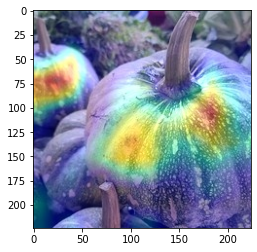

In [ ]:
img=cv.imread("/content/map.jpg")
img=cv.cvtColor(img,cv.COLOR_BGR2RGB)
plt.imshow(img)

### Useful repositories for gradcam and visualizations.
https://github.com/jacobgil/pytorch-grad-cam

https://github.com/utkuozbulak/pytorch-cnn-visualizations


# Credits
Notebook Prepared by Bostan Khan, Team Lead, MachVIS Lab